# 1. Data Exploration

## Packages

In [74]:
pip install pygam

Note: you may need to restart the kernel to use updated packages.


In [75]:
#Packages for general code running
import warnings #to ignore warning codes
warnings.filterwarnings('ignore')
import zipfile # to unzip zip files

# Packages for data processing and manipulation
import pandas as pd   # for data manipulation
import numpy as np    # for numerical processing
import glob           # to retrieve files matching a specified pattern
import geopandas as gpd #for handling geodataframes
from shapely.geometry import Point
from dateutil.relativedelta import relativedelta
from datetime import datetime
from datetime import date  # for date manipulation

# Packages for visualisation
import seaborn as sns  # for advance data visualisation
import matplotlib.pyplot as plt # for basic data visualisation

# Packages for analysis
from statsmodels.formula.api import ols # for did analysis
import scipy.stats as stats # for statistical analysis
from scipy.stats import ttest_ind # for t-test analysis
from statsmodels.iolib.summary2 import summary_col 
import re
import statsmodels.api as sm
from pygam import LinearGAM

## Loading In: Temperature and Usage

In [76]:
#  ========= LOADING IN =========

#Daily usage data
usage2018 = pd.read_csv("source_data/FOI All TfL Entries  Exits June to September 2018.csv")
usageother = pd.read_csv("source_data/FOI All TfL Entries  Exits June to September Not 2018.csv")
usageother.rename(columns = {'[SumTap_Count]': 'Tap Count', 'Stations[Station]':'Station', 'Stations[NLC]': 'NLC', 'Entry / Exit[Entry / Exit]':'Entry / Exit',
                            'Dates[Travel Date (dd/mm/yyyy)]': 'date'}, inplace = True)
usage2018.rename(columns = {'Travel Date (dd/mm/yyyy)': 'date'}, inplace = True)
usage = pd.concat([usage2018, usageother], axis=0)
usage['tap_count'] =usage['Tap Count'].astype(str).replace(',','', regex=True).astype(int)

#Temperature data
tube_temp0 = pd.read_csv("source_data/lu-average-monthly-temperatures.csv")
tube_temp1 = pd.read_csv("source_data/lu-average-monthly-temperatures_2021-2022 GLA data store updates.csv")
tube_temp= pd.concat([tube_temp0, tube_temp1], axis=0)

daily_temp = pd.read_csv("source_data/london0_23_weather_data.csv")
daily_temp['date'] = pd.to_datetime(daily_temp['date'], format='%d/%m/%Y')
daily_temp.drop([ 'tmin', 'prcp', 'wdir', 'wspd', 'wpgt', 'pres'], axis = 1, inplace = True)

#Exception days
holiday = pd.read_excel("source_data/exception_days.xlsx", sheet_name = "holiday")
strike = pd.read_excel("source_data/exception_days.xlsx", sheet_name = "strike")

In [77]:
# === FORMAT DATE COLUMNS ===
#dates
usage['date'] = pd.to_datetime(usage['date'], format='%d/%m/%Y')

# Extract year, month, day of week, weekend data
interest_years = [2018, 2019, 2022]  # define the years of interest
usage['year'] = usage['date'].dt.strftime('%Y').astype(int)
usage = usage[usage['year'].isin(interest_years)]
usage['month'] = usage['date'].dt.strftime('%m').astype(int)
usage = usage[usage['month'] != 9]

usage["day_of_week"] = usage['date'].dt.dayofweek
usage["weekend"] = usage["day_of_week"] > 4

# Make 'holiday' and 'strike' columns
usage['holiday'] = usage['date'].isin(holiday['date']).fillna(False)
usage['strike'] = usage['date'].isin(strike['date']).fillna(False)

usage.drop(['Tap Count'], axis = 1, inplace=True)

# Because entry and exit data were seperated into different rows
# We are pivoting so that it is now 2 columns instead
usage = usage.pivot_table(index=['Station', 'NLC', 'date', 'year', 'month', 'day_of_week', 'weekend', 'holiday', 'strike'],
                                 columns='Entry / Exit',
                                 values='tap_count',
                                 aggfunc='sum').reset_index()
usage.columns.name = None

# Make per station per day entry and exit total 
usage['entryexit_total'] = usage["Entry"] + usage["Exit"]

summer_usage_temp_rough = usage.merge(daily_temp, on = 'date', how = 'left')

#Remove strike days
summer_usage_temp_rough = summer_usage_temp_rough[(summer_usage_temp_rough['strike'] == False)]

In [78]:
#clean names
summer_usage_temp_rough['Station'] = summer_usage_temp_rough.Station.apply(lambda x:
                                                             re.sub(r'\bRd\b', 'Road',
                                                                    re.sub(r"\bLiverpool St\b", "Liverpool Street",
                                                                    re.sub(r'\sB\s(?!\w)', '',
                                                                           re.sub(r'\sLU\s?|\sLO\s?|\sEL\s?|\sC&H\s?|\sD&P\s?|\sSR\s?|\sNR\s?|\sTf[lL]\s?|\sDLR\s?|\sMet\s?|\s\(.*\)|[\'\.]', '', x)
                                                                          )
                                                                          )
                                                                   )
                                                             .replace("T2&3Rail/HEx", "Terminals 2 & 3")
                                                             .replace("Terminals 2&3", "Terminals 2 & 3")
                                                             .replace("T4Rail/HEx", "Terminal 4")
                                                             .replace("T5Rail/HEx", "Terminal 5")
                                                             .replace("Edgware Road B", "Edgware Road")
                                                             .replace("W Silvertown", "West Silvertown")
                                                             .replace("Kensington Olympia", "Kensington")
                                                            .replace("Shoreditch High Street", "Shoreditch")
                                                            )


In [79]:
# now that the names have been normalised, there are now rows that have the same name and same date, which is not good. 
duplicates = summer_usage_temp_rough[summer_usage_temp_rough.duplicated(subset=['date', 'Station'], keep=False)]
sorted_duplicates = duplicates.sort_values(by=['date', 'Station'])
sorted_duplicates

,Station,NLC,date,year,month,day_of_week,weekend,holiday,strike,Entry,Exit,entryexit_total,tavg,tmax,snow,dd
7750,Bethnal Green,520,2018-06-01,2018,6,4,False,False,False,23721.0,21855.0,45576.0,19.3,24.0,NaN,NaN
8024,Bethnal Green,6961,2018-06-01,2018,6,4,False,False,False,1788.0,1967.0,3755.0,19.3,24.0,NaN,NaN
15657,Canary Wharf,666,2018-06-01,2018,6,4,False,False,False,3134.0,8963.0,12097.0,19.3,24.0,NaN,NaN
15841,Canary Wharf,852,2018-06-01,2018,6,4,False,False,False,55329.0,67202.0,122531.0,19.3,24.0,NaN,NaN
16115,Canary Wharf,842,2018-06-01,2018,6,4,False,False,False,14186.0,13942.0,28128.0,19.3,24.0,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
106390,Waterloo,796,2022-08-31,2022,8,2,False,False,False,41863.0,42345.0,84208.0,16.4,21.1,NaN,NaN
109937,West Hampstead,758,2022-08-31,2022,8,2,False,False,False,10676.0,9975.0,20651.0,16.4,21.1,NaN,NaN
110203,West Hampstead,1421,2022-08-31,2022,8,2,False,False,False,6278.0,6314.0,12592.0,16.4,21.1,NaN,NaN
115874,Woolwich Arsenal,573,2022-08-31,2022,8,2,False,False,False,7710.0,7990.0,15700.0,16.4,21.1,NaN,NaN


In [80]:
# So here we groupby station and dates, and sum up the entry and exit totals
summer_usage_temp_rough = summer_usage_temp_rough.groupby(['Station', 'date', 'month' ,'weekend','holiday', 'strike',
                                       'tavg', 'tmax'], as_index=False)['Entry', 'Exit', 'entryexit_total'].sum()

In [81]:
summer_weekend_usage_temp = summer_usage_temp_rough[(summer_usage_temp_rough['weekend'] == True) | (summer_usage_temp_rough['holiday'] == True)]

#### Find stations with less than 29 rows
Remove stations that dont have enough rows in the dataset.
ie Barking Riverside only has 8 rows of data out of 84 days.
So we need to remove it as it is not enough for line by line analysis, and it will skew our overall data.

### Remove rows

12 rows are removed, leaving 405 stations left in the analysis.

In [82]:
summer_weekend_usage_temp = summer_weekend_usage_temp.reset_index()
wknd_v_count = summer_weekend_usage_temp['Station'].value_counts().reset_index()
wknd_v_count.columns = ['Station', 'count']

# the number of stations in the network
print(len(wknd_v_count))
print(wknd_v_count.head())
print(wknd_v_count.describe())

wknd_v_count_out = wknd_v_count[wknd_v_count['count'] <= 29]
remove_stns = wknd_v_count_out['Station'].tolist()

417
                  Station  count
0              Abbey Road     83
1              Paddington     83
2  Kings Cross St Pancras     83
3           Knightsbridge     83
4           Lambeth North     83
            count
count  417.000000
mean    77.695444
std     11.511524
min      8.000000
25%     79.000000
50%     82.000000
75%     83.000000
max     83.000000


In [83]:
wknd_v_count_out

,Station,count
405,Taplow,28
406,Twyford,28
407,Slough,28
408,Burnham Bucks,28
409,Langley Berks,28
410,Maidenhead,28
411,Battersea Power Station,28
412,Reading,28
413,Nine Elms,28
414,Iver,28


### Remove rows

12 rows are removed, leaving 405 stations left in the analysis.

In [84]:
summer_weekend_usage_temp = summer_weekend_usage_temp[~summer_weekend_usage_temp['Station'].isin(remove_stns)]


In [85]:
outside_ldn = ['Amersham', 'Chalfont & Latimer', 'Chesham', 'Croxley', 'Chorleywood', 'Debden', 'Epping',
'Loughton', 'Moor Park', 'Rickmansworth', 'Theydon Bois', 'Watford', 'Brentwood', 'Bushey', 'Cheshunt', 
'Carpenders Park', 'Shenfield', 'Theobalds Grove', 'Watford High Street', 'Watford Junction']

In [86]:
summer_weekend_usage_temp = summer_weekend_usage_temp[~summer_weekend_usage_temp['Station'].isin(outside_ldn)]
len(summer_weekend_usage_temp)

30515

In [87]:
len(summer_weekend_usage_temp['Station'].unique())

385

## Get Variables

In [88]:
#Get network wide data 
network_daily_total = summer_weekend_usage_temp.groupby(['date'])['entryexit_total'].sum().reset_index()
network_daily_total.rename(columns = {'entryexit_total': 'network_entryexit_total'}, inplace = True)

summer_weekend_usage_temp = summer_weekend_usage_temp.merge(network_daily_total, on = 'date')

In [89]:
#Get log data
# summer_usage_temp['lognetwork_entryexit_total']=np.log(summer_usage_temp['network_entryexit_total'])
# summer_usage_temp['log_entryexit_total']=np.log(summer_usage_temp['entryexit_total'])

#Travel Proportions
summer_weekend_usage_temp['percent_daily_total'] = summer_weekend_usage_temp['entryexit_total']/summer_weekend_usage_temp['network_entryexit_total']

#Drop columns
summer_weekend_usage_temp.drop(['Entry', 'Exit'], axis =1, inplace =True)

# #Filter Outliers
# def filter_outliers(var):
#     q1 = var.quantile(0.25) # calculate the first quartile
#     q3 = var.quantile(0.75) # calculate the third quartile
#     iqr = q3 - q1 # calculate the interquartile range
#     low = q1 - 3*iqr # calculate the lower bound
#     high = q3 + 3*iqr # calculate the upper bound
#     filtered = summer_usage_temp[(var > low) & (var < high)] # filter  the values that are within the bounds
#     dropped_observations= len(var)-len(filtered) # calculate the number of observations that were dropped

#     print('Dropped {} observations'.format(dropped_observations))
#     return  filtered

# summer_usage_temp=filter_outliers(summer_usage_temp['network_entryexit_total']) # filter outliers from entryexit_total
# summer_usage_temp = summer_usage_temp[summer_usage_temp['network_entryexit_total'] > 2000000]

### Exploring idea of analysis by station duplications by LU, LO, NR, EL etc
Conclusion is eg: not every EL stations have a separate EL row, because the gates are integrated for most of the line. 
Cant do analysis like that bc we dont have complete data, nor can we remove it bc it'll only remove EL data for those with separate rows.

Essentially have to do the aggregate station method, according to the network.

We could still remove the NR entries though?

In [90]:
# data_station_names = {row.NLC: row['Station'] for i, row in usage.iterrows()}
# # # network_station_names.to_csv('network_station_names.csv')

# df = pd.DataFrame(data_station_names.items(), columns=['nlc_id', 'Name'])

# data_station_names = df

# data_station_names['nlc_id'] = data_station_names['nlc_id'].astype(str)

# data_station_names.rename(columns={'Name': 'data_station_names'}, inplace=True)

In [91]:
# data_station_names['data_station_names'].unique()

In [92]:
# data_station_names[data_station_names['nlc_id'] == '308700']

In [93]:
# network_station_names = pd.read_csv("Code/network_station_names.csv")

# # merged_df = pd.merge(network_station_names, data_station_names, on = 'nlc_id', how='outer')

# # Find the differences between the two string columns
# merged_df['Difference'] = merged_df['data_station_names'] != merged_df['Name']

# # Optional: If you want to see the rows where the values are different
# different_rows = merged_df[merged_df['Difference']]

In [94]:
# merged_df[merged_df['Difference'] == False]

In [95]:
# different_rows

In [96]:
# rows_with_nan = merged_df[merged_df['Name'].isna() | merged_df['data_station_names'].isna()]

In [97]:
# rows_with_nan[80:]

In [98]:
# merged_df[merged_df['data_station_names']== 'Canary Wharf']

# Network Wide (Problem)

## Problem Outline (Network level Visualise & Regression)

Situation of the data:

There are 3 clear clusters in the station usage dataset:

* usage when total network volumne is under 6000000
* usage when total network volumne is between 6000000 and 8000000
* usage when total network volumne is above 8000000

This is corresponded but the number of station closure and/or number of dates closure.

And we found that when the network is fully functioning (ie v little closures), they are almost of weekdays.

This means the data we bring forrward does not include the largest lump. This is okay, but we are still left with 2 lumps, unable to proceed with Linear regression bc it is extreme he teroscedastic, violating the linear regression asusmption. fantastic.

What does this mean? Meaning we cannot accurately run a linear regression with temp x network's daily total entry and exists.
And when you run a regression wit the individual lumps, the weekend lumps shows 0 r2 and insignificant p values.

So we cannot run a whole network regression
Can we run a station base regression though?
if some stations are prone to closure on the weeknds, ie the overground, the data will be skewed bc it will have some rlly low days...
Will it be ok if I remove those closure days?
The dataset for that line will be smaller, but it wont be skewed.

In [99]:
summer_weekend_usage_temp.describe()

,index,month,tavg,tmax,entryexit_total,network_entryexit_total,percent_daily_total
count,30515.000000,30515.000000,30515.000000,30515.000000,30515.000000,3.051500e+04,30515.000000
mean,55337.891136,6.999017,18.225388,22.843769,15194.907718,5.596515e+06,0.002720
std,31535.836917,0.823039,2.862699,4.022843,25424.452135,1.086977e+06,0.004455
min,1.000000,6.000000,12.700000,15.000000,0.000000,3.998730e+06,0.000000
25%,28846.500000,6.000000,16.400000,20.000000,3375.000000,4.667706e+06,0.000623
50%,55107.000000,7.000000,17.900000,22.500000,6995.000000,5.159974e+06,0.001270
75%,82433.000000,8.000000,20.000000,25.500000,15224.000000,6.500408e+06,0.002722
max,110253.000000,8.000000,24.700000,32.800000,257099.000000,7.890201e+06,0.043769


## Checking out the lumps

(array([1455.,  749., 1827., 1434., 1843., 2554., 2200.,  740., 2560.,
         676.,  362.,  331.,  767.,    0.,    0., 1089.,  747., 1121.,
        1111., 1486., 1494.,  369., 1093.,  759., 1512., 1107.,  765.,
           0.,    0.,  364.]),
 array([3998730. , 4128445.7, 4258161.4, 4387877.1, 4517592.8, 4647308.5,
        4777024.2, 4906739.9, 5036455.6, 5166171.3, 5295887. , 5425602.7,
        5555318.4, 5685034.1, 5814749.8, 5944465.5, 6074181.2, 6203896.9,
        6333612.6, 6463328.3, 6593044. , 6722759.7, 6852475.4, 6982191.1,
        7111906.8, 7241622.5, 7371338.2, 7501053.9, 7630769.6, 7760485.3,
        7890201. ]),
 <BarContainer object of 30 artists>)

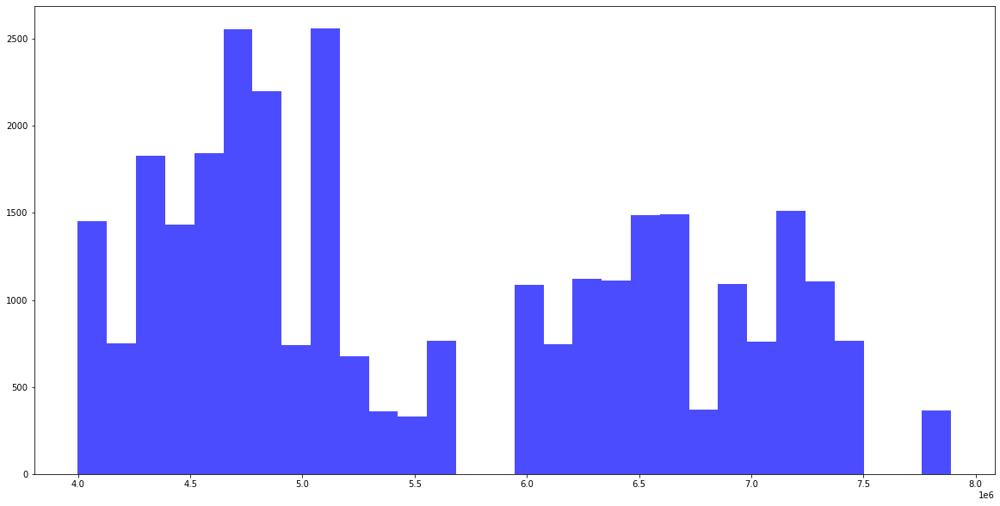

In [100]:
plt.hist(summer_weekend_usage_temp['network_entryexit_total'], bins=30, color='blue', alpha=0.7)

In [101]:
# below_6 = summer_weekend_usage_temp[summer_weekend_usage_temp['network_entryexit_total']< 6000000]
# ab_6 = summer_weekend_usage_temp[(summer_weekend_usage_temp['network_entryexit_total']> 6000000)]
                           
# print('Size of lump df')
# print(len(below_6))
# print(len(ab_6))

# print('=======')

# print('DATES')
# print(f" There are {len(summer_weekend_usage_temp['date'].unique())} in the whole df.") # total num of unique days.
# print(f" There are {len(below_6['date'].unique())} days in the 1st lump.")
# print(f" There are {len(ab_6['date'].unique())} days in the 2nd lump.")

In [102]:
# # Check out the number of closed stations there are per lump.
# ## Definition of station closure is stations that are below 300 in daily usage or is empty.

# bl6_closure_count = below_6[(below_6['entryexit_total'] < 100) | (below_6['entryexit_total'].isna())].groupby('date')['Station'].count().reset_index()
# print(f" There are {len(bl6_closure_count['Station'])} closed stations in the 1st lump.")

# ab6_closure_count =ab_6[(ab_6['entryexit_total'] < 100) | (ab_6['entryexit_total'].isna())].groupby('date')['Station'].count().reset_index()
# print(f" There are {len(ab6_closure_count['Station'])} closed stations in the 2nd lump.")


In [103]:
# #Looking at the whole df
# closed_stn =summer_weekend_usage_temp[(summer_weekend_usage_temp['entryexit_total'] < 500) | (summer_weekend_usage_temp['entryexit_total'].isna())]
# print(f" There are {len(closed_stn['Station'].unique())} unique stations that closed in the df.")
# print(f"There are {len(closed_stn['date'].unique())} days that had at least 1 station closure in the whole df.")
# print(f" There are {len(summer_weekend_usage_temp['date'].unique())} days in total in the whole df.")

# # plt.hist(x['entryexit_total'], bins=70, color='blue', alpha=0.7)
# #Histogram shows that loads of 0 days within the closure df.

In [104]:
# Here Im trying to remove the stations on specific days where the station is closed.
summer_weekend_usage_temp_ = summer_weekend_usage_temp[~((summer_weekend_usage_temp['entryexit_total'] < 100) | (summer_weekend_usage_temp['entryexit_total'].isna()))]
# summer_weekend_usage_temp_ = summer_weekend_usage_temp[~(summer_weekend_usage_temp['entryexit_total'].isna())]

(array([1816., 2167., 2129., 3602., 2878., 2517., 1018.,  324.,  767.,
           0., 1078., 1847., 2550., 1482.,  729., 1461., 1502., 1844.,
           0.,  355.]),
 array([3998730.  , 4193303.55, 4387877.1 , 4582450.65, 4777024.2 ,
        4971597.75, 5166171.3 , 5360744.85, 5555318.4 , 5749891.95,
        5944465.5 , 6139039.05, 6333612.6 , 6528186.15, 6722759.7 ,
        6917333.25, 7111906.8 , 7306480.35, 7501053.9 , 7695627.45,
        7890201.  ]),
 <BarContainer object of 20 artists>)

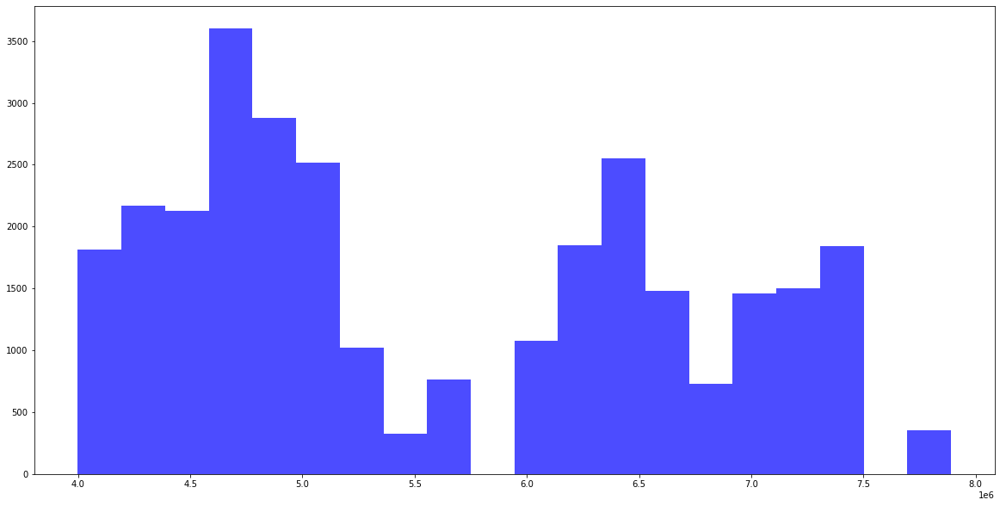

In [105]:
plt.hist(summer_weekend_usage_temp_['network_entryexit_total'], bins=20, color='blue', alpha=0.7)

Cant say the df looks any better when comparing the dfs. oh well.

In [106]:
summer_weekend_usage_temp.describe()

,index,month,tavg,tmax,entryexit_total,network_entryexit_total,percent_daily_total
count,30515.000000,30515.000000,30515.000000,30515.000000,30515.000000,3.051500e+04,30515.000000
mean,55337.891136,6.999017,18.225388,22.843769,15194.907718,5.596515e+06,0.002720
std,31535.836917,0.823039,2.862699,4.022843,25424.452135,1.086977e+06,0.004455
min,1.000000,6.000000,12.700000,15.000000,0.000000,3.998730e+06,0.000000
25%,28846.500000,6.000000,16.400000,20.000000,3375.000000,4.667706e+06,0.000623
50%,55107.000000,7.000000,17.900000,22.500000,6995.000000,5.159974e+06,0.001270
75%,82433.000000,8.000000,20.000000,25.500000,15224.000000,6.500408e+06,0.002722
max,110253.000000,8.000000,24.700000,32.800000,257099.000000,7.890201e+06,0.043769


In [107]:
summer_weekend_usage_temp_.describe()

,index,month,tavg,tmax,entryexit_total,network_entryexit_total,percent_daily_total
count,30066.000000,30066.000000,30066.000000,30066.000000,30066.000000,3.006600e+04,30066.000000
mean,55351.924333,7.000100,18.226605,22.847333,15421.634438,5.597802e+06,0.002761
std,31474.468691,0.823507,2.860400,4.020402,25545.305380,1.087270e+06,0.004475
min,1.000000,6.000000,12.700000,15.000000,101.000000,3.998730e+06,0.000016
25%,28901.250000,6.000000,16.400000,20.000000,3512.250000,4.667706e+06,0.000643
50%,55143.000000,7.000000,17.900000,22.500000,7126.000000,5.159974e+06,0.001294
75%,82385.500000,8.000000,20.000000,25.500000,15455.750000,6.500408e+06,0.002776
max,110253.000000,8.000000,24.700000,32.800000,257099.000000,7.890201e+06,0.043769


The new df has a smaller difference between mean and median, so it did get better in a way.

### Unsure section

Not sure what below is for?

In [108]:
# data_station_names = {row.NLC: row['Station'] for i, row in summer_usage_temp.iterrows()}

# df = pd.DataFrame(data_station_names.items(), columns=['nlc_id', 'Name'])

# data_station_names = df

# data_station_names['nlc_id'] = data_station_names['nlc_id'].astype(str)

# data_station_names.rename(columns={'Name': 'data_station_names'}, inplace=True)

In [109]:
# network_station_names = pd.read_csv("network_station_names.csv")

# merged_df = pd.merge(network_station_names, data_station_names, right_on = 'data_station_names', left_on = 'Name', how='outer')

# # Find the differences between the two string columns
# merged_df['Difference'] = merged_df['data_station_names'] != merged_df['Name']

# # Optional: If you want to see the rows where the values are different
# different_rows = merged_df[merged_df['Difference']]

From the above, the data that data_station_names dont have, will automatically be removed when visualising on the network. 

The few rows that the network does have data on but the data does -- Barking Riverside, Battersea, Burnham Bucks, Langley Berks, New Cross, Nine Elms and Woolwich

### Regression

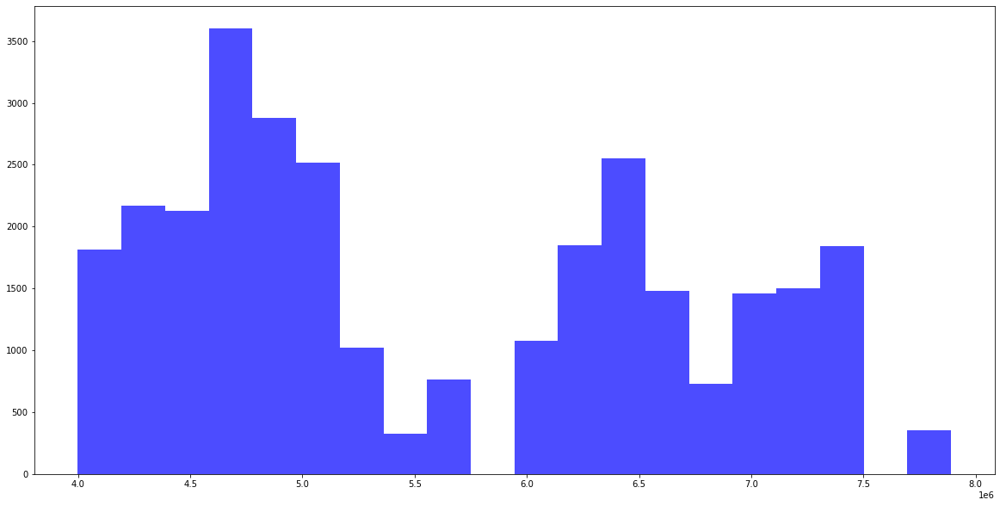

In [110]:
plt.hist(summer_weekend_usage_temp_['network_entryexit_total'], bins=20, color='blue', alpha=0.7)

plt.savefig("output/weekend_usage_hist.png")

This shows, when network wide entry and exit data is above 8000000, its always on weekdays.

Closures always happen on weekends!!

In [111]:
model_WE= ols('network_entryexit_total ~  tmax', data=summer_weekend_usage_temp_).fit()
print(model_WE.summary()) # print the summary

                               OLS Regression Results                              
Dep. Variable:     network_entryexit_total   R-squared:                       0.000
Model:                                 OLS   Adj. R-squared:                  0.000
Method:                      Least Squares   F-statistic:                     8.057
Date:                     Fri, 25 Aug 2023   Prob (F-statistic):            0.00454
Time:                             11:19:23   Log-Likelihood:            -4.6055e+05
No. Observations:                    30066   AIC:                         9.211e+05
Df Residuals:                        30064   BIC:                         9.211e+05
Df Model:                                1                                         
Covariance Type:                 nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
In

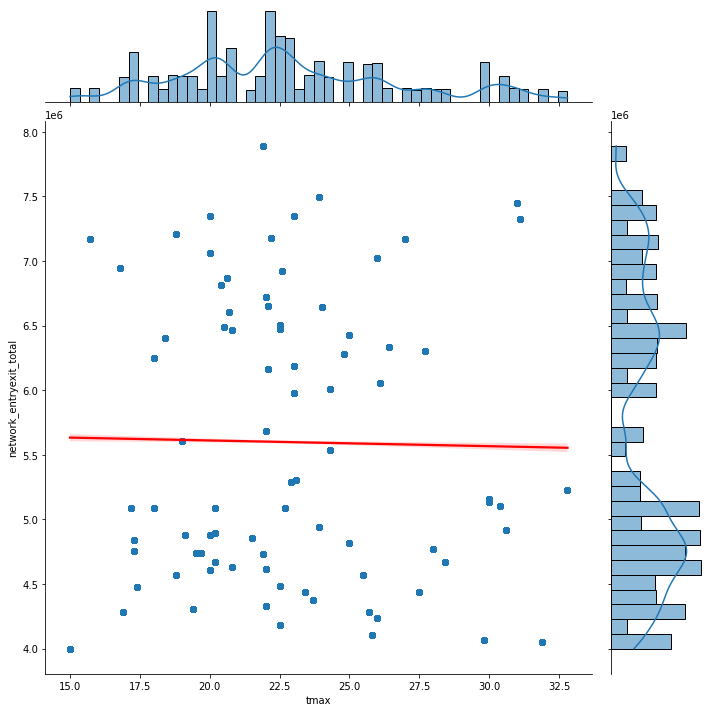

In [112]:
sns.jointplot(data=summer_weekend_usage_temp_, x='tmax', y='network_entryexit_total', kind="reg",  scatter_kws=dict(alpha=0.1), line_kws=dict(color='red'), height=10)

plt.savefig("output/weekend_usage_correplot.png")

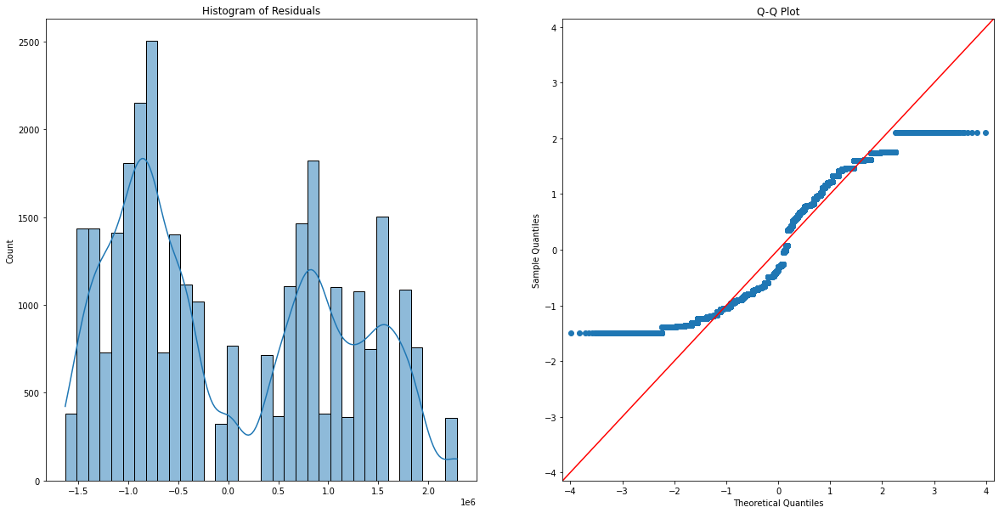

In [113]:
residuals_WE = model_WE.resid # get the residuals

# make the figure wider
plt.rcParams["figure.figsize"] = [20, 10]

f, axes = plt.subplots(1, 2)
sns.histplot(residuals_WE, kde=True, ax=axes[0]) # plot the residuals
axes[0].set_title('Histogram of Residuals') # add a title

sm.qqplot(residuals_WE, line='45', fit=True,  ax=axes[1]) # plot the residuals
axes[1].set_title('Q-Q Plot') # add a title

plt.show() # show the plot

# Line by Line

## Line by Line filtering

Can do a line by line regression with larger lump only?

In [114]:

def filter_outliers_by_station(df, var_name):
    filtered_data = pd.DataFrame()  # Create an empty DataFrame to store filtered data
    
    # Group the data by 'Station'
    grouped = df.groupby('Station')
    
    for group_name, group_data in grouped:
        group_var = group_data[var_name]  # Extract the variable of interest
        
        q1 = group_var.quantile(0.25)  # Calculate the first quartile
        q3 = group_var.quantile(0.75)  # Calculate the third quartile
        iqr = q3 - q1  # Calculate the interquartile range
        low = q1 -  4*iqr  # Calculate the lower bound
        high = q3 + 5* iqr  # Calculate the upper bound
        
        # Filter the values that are within the bounds for this station
        filtered_group = group_data[(group_var > low) & (group_var < high)]
        
        filtered_data = filtered_data.append(filtered_group)  # Append the filtered data
        
        dropped_observations = len(group_var) - len(filtered_group)  # Calculate dropped observations
        print('For Station {}: Dropped {} observations'.format(group_name, dropped_observations))
    
    return filtered_data

# Apply the function to filter outliers by 'entryexit_total'
filtered_data = filter_outliers_by_station(summer_weekend_usage_temp_, 'entryexit_total')

For Station Abbey Road: Dropped 0 observations
For Station Abbey Wood: Dropped 0 observations
For Station Acton Central: Dropped 0 observations
For Station Acton Main Line: Dropped 0 observations
For Station Acton Town: Dropped 0 observations
For Station Aldgate: Dropped 0 observations
For Station Aldgate East: Dropped 0 observations
For Station All Saints: Dropped 0 observations
For Station Alperton: Dropped 0 observations
For Station Anerley: Dropped 0 observations
For Station Angel: Dropped 0 observations
For Station Archway: Dropped 0 observations
For Station Arnos Grove: Dropped 0 observations
For Station Arsenal: Dropped 9 observations
For Station Baker Street: Dropped 0 observations
For Station Balham: Dropped 0 observations
For Station Bank: Dropped 0 observations
For Station Barbican: Dropped 0 observations
For Station Barking: Dropped 0 observations
For Station Barkingside: Dropped 0 observations
For Station Barons Court: Dropped 0 observations
For Station Bayswater: Dropped 

In [115]:
filtered_data.describe()

,index,month,tavg,tmax,entryexit_total,network_entryexit_total,percent_daily_total
count,30023.000000,30023.000000,30023.000000,30023.000000,30023.000000,3.002300e+04,30023.000000
mean,55360.632149,6.999567,18.226660,22.847177,15418.167971,5.597413e+06,0.002760
std,31463.602233,0.823450,2.860363,4.020067,25560.781944,1.087283e+06,0.004478
min,1.000000,6.000000,12.700000,15.000000,101.000000,3.998730e+06,0.000016
25%,28936.500000,6.000000,16.400000,20.000000,3510.500000,4.667706e+06,0.000643
50%,55139.000000,7.000000,17.900000,22.500000,7116.000000,5.159974e+06,0.001293
75%,82377.000000,8.000000,20.000000,25.500000,15428.500000,6.500408e+06,0.002764
max,110253.000000,8.000000,24.700000,32.800000,257099.000000,7.890201e+06,0.043769


(array([3981., 5726., 5386., 1338.,  765., 2921., 4026., 2187., 3339.,
         354.]),
 array([3998730. , 4387877.1, 4777024.2, 5166171.3, 5555318.4, 5944465.5,
        6333612.6, 6722759.7, 7111906.8, 7501053.9, 7890201. ]),
 <BarContainer object of 10 artists>)

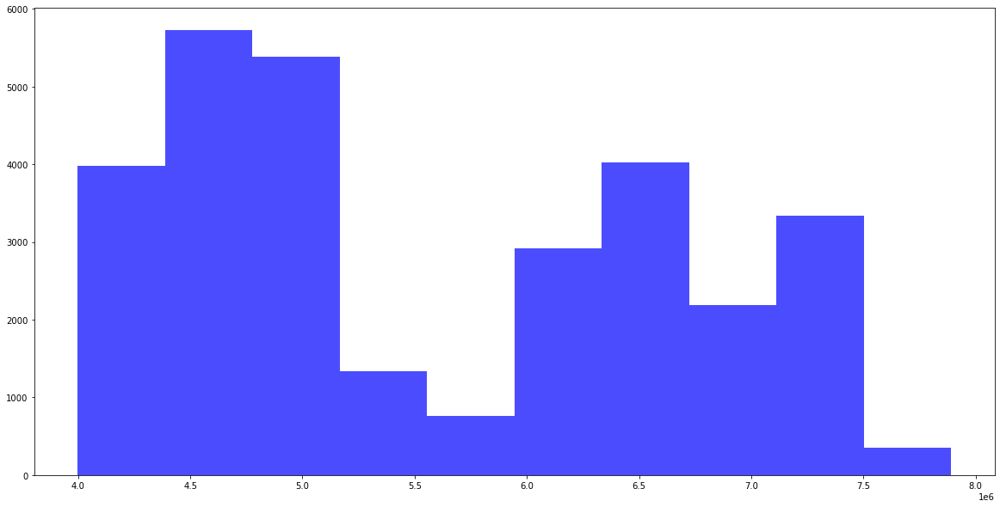

In [116]:
plt.hist(filtered_data['network_entryexit_total'], bins=10, color='blue', alpha=0.7)

## Visualising station by station approach

### Line by line viz

In [117]:
# summer_weekend_usage_temp
# summer_usage_temp
filtered_data.columns

Index(['index', 'Station', 'date', 'month', 'weekend', 'holiday', 'strike',
       'tavg', 'tmax', 'entryexit_total', 'network_entryexit_total',
       'percent_daily_total'],
      dtype='object')

In [118]:
# Extract df with only 28C + days
filtered_data28plus = filtered_data[filtered_data['tmax'] >= 28]
print(len(filtered_data28plus['date'].unique()))

11


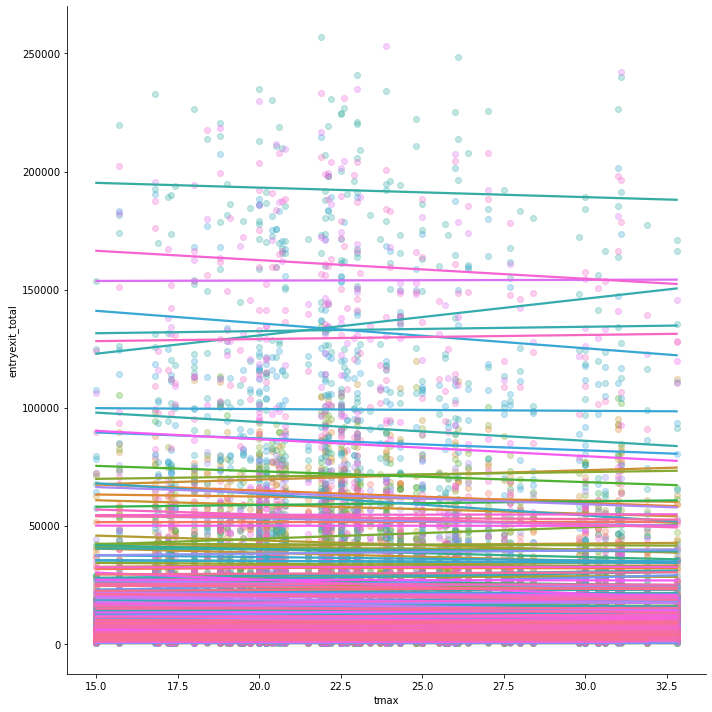

In [119]:
#entryexit_total
sns.lmplot(data=filtered_data, x='tmax', y='entryexit_total', ci=None, hue='Station', height=10, legend=False, palette='husl', scatter_kws={'alpha':.3})

plt.savefig("output/lines_corr_entryexit_total.png")

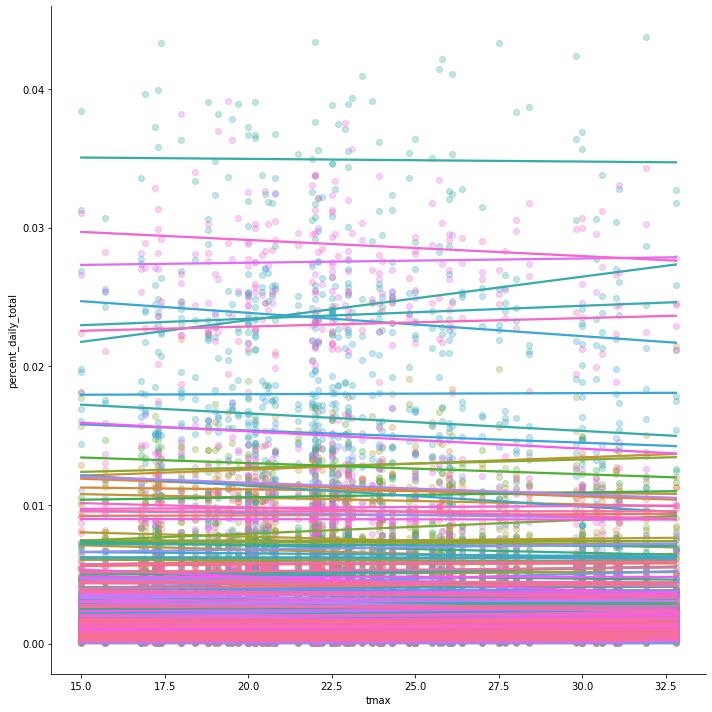

In [120]:
# percent_daily_total

sns.lmplot(data=filtered_data, x='tmax', y='percent_daily_total', ci=None, hue='Station', height=10, legend=False, palette='husl', scatter_kws={'alpha':.3})

plt.savefig("output/lines_corr_percent_daily_total.png")


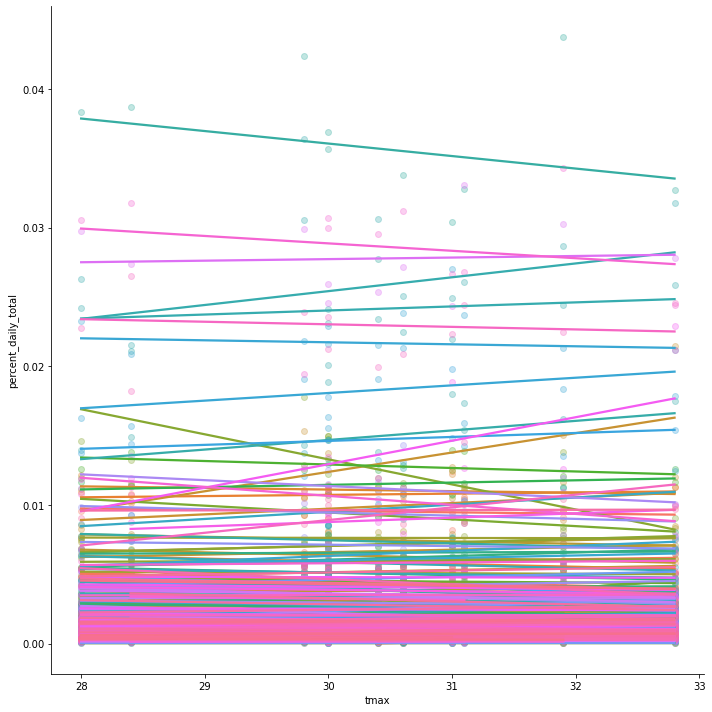

In [121]:
sns.lmplot(data=filtered_data28plus, x='tmax', y='percent_daily_total', ci=None, hue='Station', height=10, legend=False, palette='husl', scatter_kws={'alpha':.3})

plt.savefig("output/lines_corr_percent_daily_total28.png")


##  Station by station Regression

### Examples: Holborn & Hampstead Heath

### Regressions

$$Percentage\ of\ Total\ Travel\ _(log) = \beta_0 + \beta_1 \times Temperature\ +\epsilon $$

#### weekend, percent total usage

In [122]:
## === Regression for weekend and holiday usage data === 

unique_variables = set(filtered_data['Station'])

datasets = {}
results_list = []


for data in unique_variables:
    datasets[data] =filtered_data[(filtered_data['Station']==data)]
    model= ols('percent_daily_total~  tmax', data=datasets[data]).fit() # fit the model
    
    results = {}

    results['Intercept'] = model.params[0]
    results['tmax'] = model.params[1]
    results['p-value'] = model.pvalues['tmax']
    results['r2'] = model.rsquared
    results['station'] = data
    results_list.append(results)

lin_reg_results = pd.DataFrame(results_list, index=range(len(results_list)))

lin_reg_results = lin_reg_results.sort_values(by='p-value', ascending=False) # or tmax

# Create a new column based on the sign of 'tmax'
lin_reg_results['coef_sign'] = (lin_reg_results['tmax'] > 0).astype(int)

lin_reg_results_pval = lin_reg_results[lin_reg_results['p-value'] < 0.05 ]
print(len(lin_reg_results_pval))

lin_reg_results_pval = lin_reg_results_pval.sort_values(by='r2', ascending=False) # or tmax

lin_reg_results_pval.to_csv('data/lin_reg_results_pval.csv', index=False)

68


#### weekend, percent total usage, above 28C

AYO LETS BE REAL WE DONT REALLY KNOW WHAT THIS IS FOR. THERE IS LITTLE CORRELATION/TREND WHEN TEMPERATURE IS ALREADY HOT. LIKE.

In [123]:
unique_variables = set(filtered_data28plus['Station'])

datasets = {}
results_list = []


for data in unique_variables:
    datasets[data] =filtered_data28plus[(filtered_data28plus['Station']==data)]
    model= ols('percent_daily_total~  tmax', data=datasets[data]).fit() # fit the model
    
    results = {}

    results['Intercept'] = model.params[0]
    results['tmax'] = model.params[1]
    results['p-value'] = model.pvalues['tmax']

    results['r2'] = model.rsquared
    results['station'] = data
    results_list.append(results)

lin_reg_results_28C = pd.DataFrame(results_list, index=range(len(results_list)))

lin_reg_results_28C = lin_reg_results_28C.sort_values(by='p-value', ascending=True)  # or tmax

# Create a new column based on the sign of 'tmax'
lin_reg_results_28C['coef_sign'] = (lin_reg_results_28C['tmax'] > 0).astype(int)

lin_reg_results_28C_pvalue = lin_reg_results_28C[lin_reg_results_28C['p-value'] < 0.05 ]

lin_reg_results_28C_pvalue = lin_reg_results_28C_pvalue.sort_values(by='r2', ascending=False) # or tmax
print(len(lin_reg_results_28C_pvalue))

lin_reg_results_28C_pvalue.to_csv('data/lin_reg_results_28C_pvalue.csv', index=False)

59


In [124]:
lin_reg_results_28C_pvalue[lin_reg_results_28C_pvalue['coef_sign'] == 1]

,Intercept,tmax,p-value,r2,station,coef_sign
251,-0.005126,0.000175,0.002874,0.913757,West Ealing,1
335,-0.006729,0.000222,0.003047,0.911231,Acton Main Line,1
56,-0.004677,0.000155,0.013846,0.900002,Hanwell,1
233,-0.006280,0.000278,0.016403,0.584645,Ladbroke Grove,1
208,-0.003708,0.000137,0.010043,0.539499,Maryland,1
42,-0.001825,0.000079,0.012738,0.516265,Harold Wood,1
69,-0.002684,0.000144,0.013089,0.513543,Kennington,1
180,-0.001304,0.000062,0.047944,0.505757,Kentish Town West,1
79,-0.017763,0.000681,0.016867,0.487510,Farringdon,1
123,-0.002256,0.000092,0.020088,0.468881,West Drayton,1


In [125]:
len(lin_reg_results_28C_pvalue[lin_reg_results_28C_pvalue['coef_sign'] == 0])

38

## GAM

### Overall Data Regression: entryexit_total

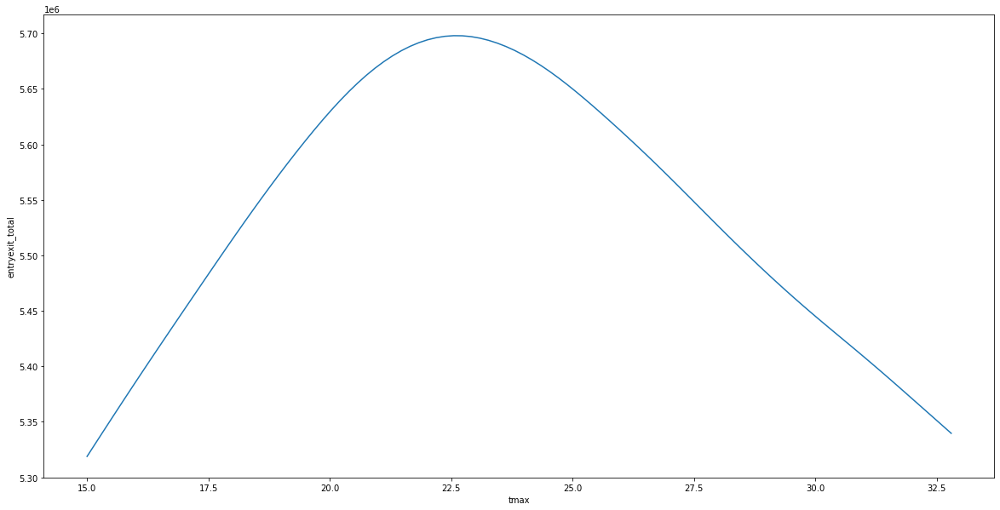

In [126]:
X = filtered_data['tmax']
y = filtered_data['network_entryexit_total']

gam = LinearGAM(lam = 1e6, n_splines= 39).fit(X, y)


XX = gam.generate_X_grid(term= 0)
plt.plot(XX, gam.predict(XX), label='LinearGAM')

# plt.scatter(X, y, color='red', label='Data Points')

# # Add labels and a legend
plt.xlabel('tmax')
plt.ylabel('entryexit_total')

plt.savefig("output/GAM_overall_line.png")

# plt.show()

In [127]:
gam.summary()

LinearGAM                                                                                                 
=============================================== ==========================================================
Distribution:                        NormalDist Effective DoF:                                      3.0231
Link Function:                     IdentityLink Log Likelihood:                               -861560.0619
Number of Samples:                        30023 AIC:                                          1723128.1701
                                                AICc:                                         1723128.1714
                                                GCV:                                    1158226048058.9377
                                                Scale:                                  1158016124561.3264
                                                Pseudo R-Squared:                                   0.0205
Feature Function                  Lam

In [128]:
X = X.to_numpy().reshape(-1, 1)

gam=LinearGAM(n_splines= 50).gridsearch(X, y)

gam.summary()

100% (11 of 11) |########################| Elapsed Time: 0:00:49 Time:  0:00:49


LinearGAM                                                                                                 
=============================================== ==========================================================
Distribution:                        NormalDist Effective DoF:                                     42.9558
Link Function:                     IdentityLink Log Likelihood:                               -838830.6933
Number of Samples:                        30023 AIC:                                          1677749.2983
                                                AICc:                                         1677749.4302
                                                GCV:                                     544558816445.8417
                                                Scale:                                   543156551067.0627
                                                Pseudo R-Squared:                                   0.5412
Feature Function                  Lam

100% (11 of 11) |########################| Elapsed Time: 0:00:14 Time:  0:00:14


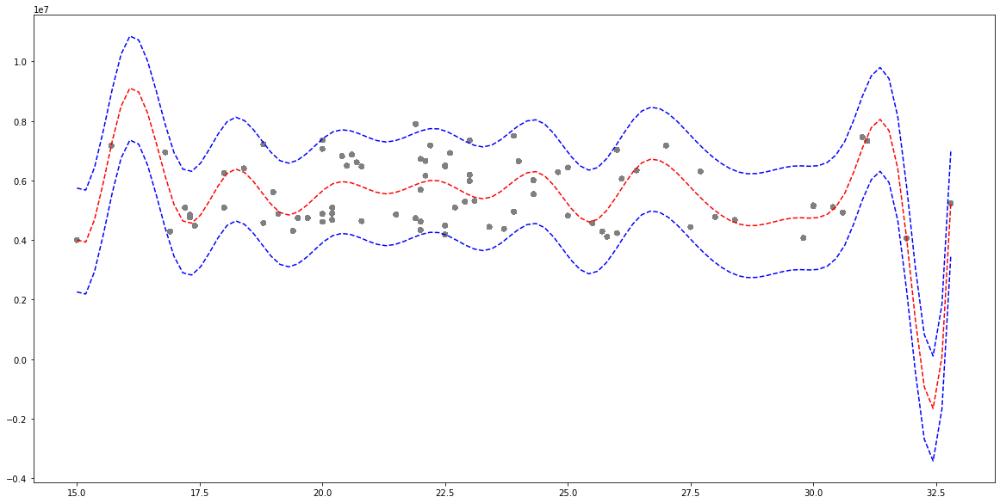

In [129]:
gam = LinearGAM().gridsearch(X, y)
XX = gam.generate_X_grid(term = 0)

plt.plot(XX, gam.predict(XX), 'r--')
plt.plot(XX, gam.prediction_intervals(XX, width=.95), color='b', ls='--')

plt.scatter(X, y, facecolor='gray', edgecolors='none')
# plt.title('95% prediction interval')

plt.savefig("output/GAM_network_95interval.png")

#### Generalised Cross Validation to decide on spline numbers

The results returns 39 as the optimal spline number.

### Per station Regression: entryexit_total

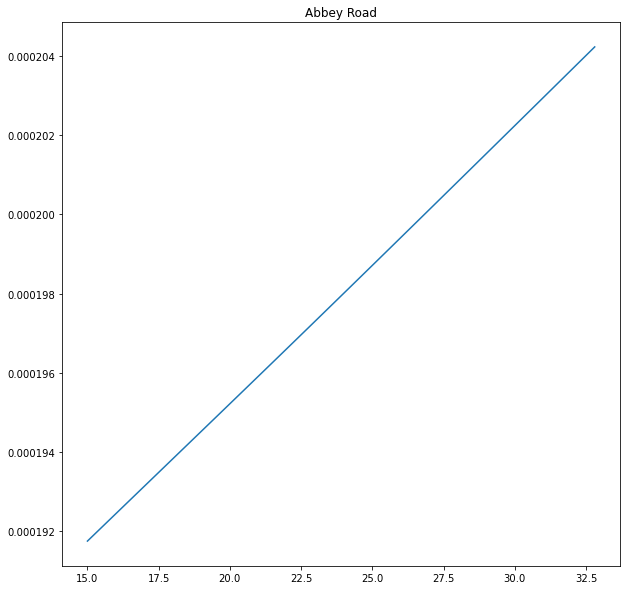

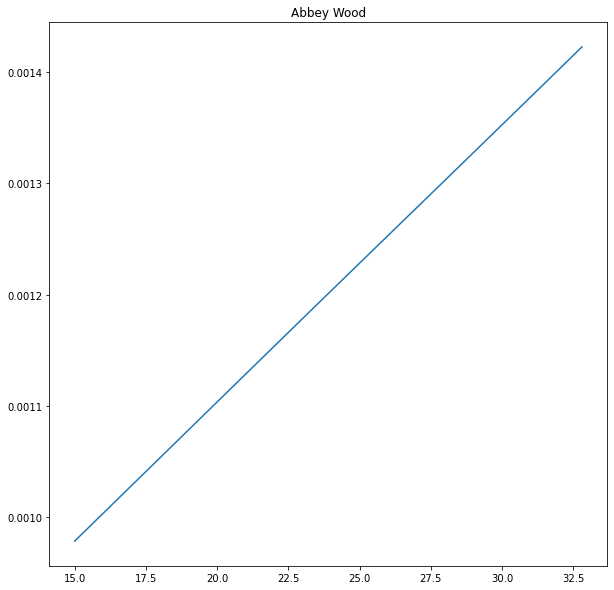

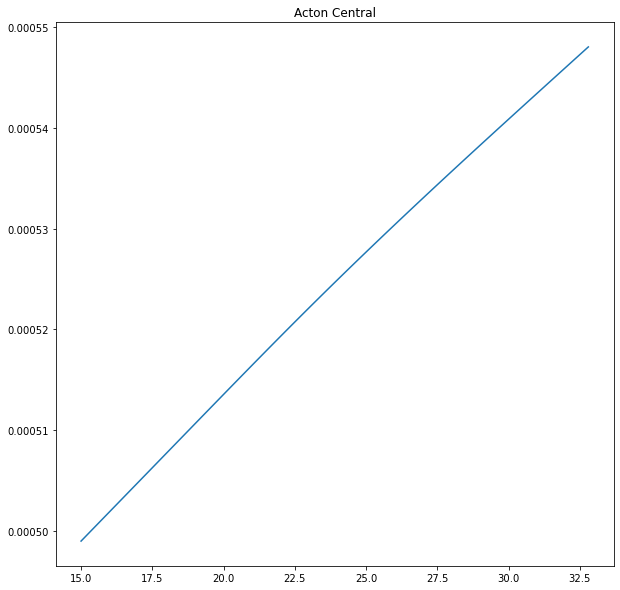

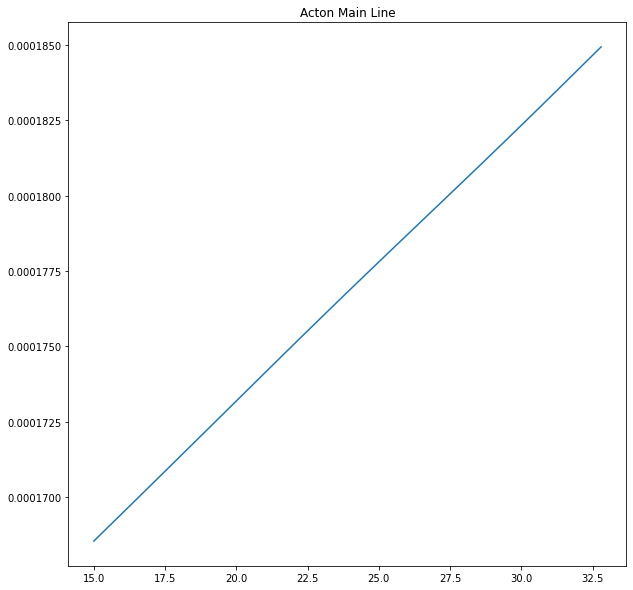

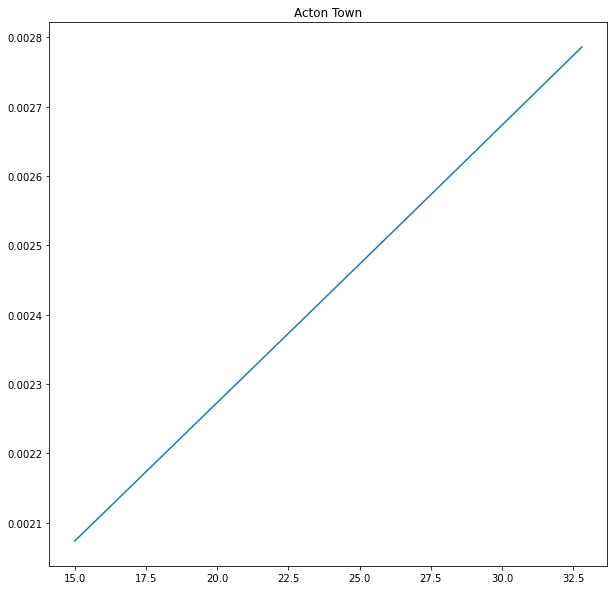

...

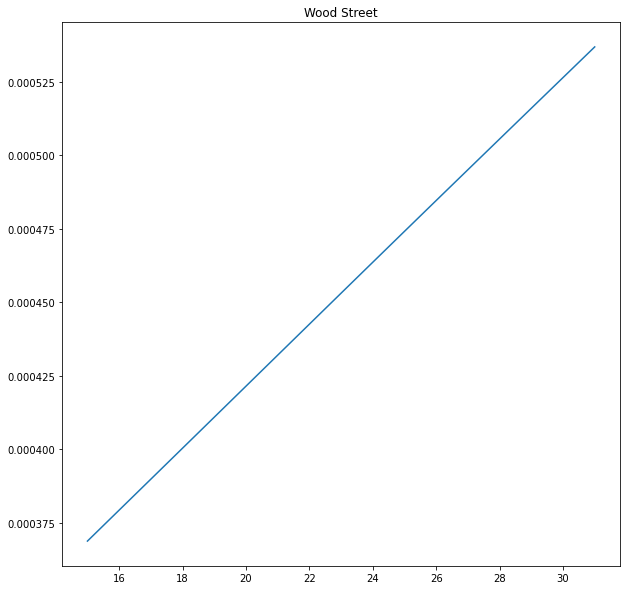

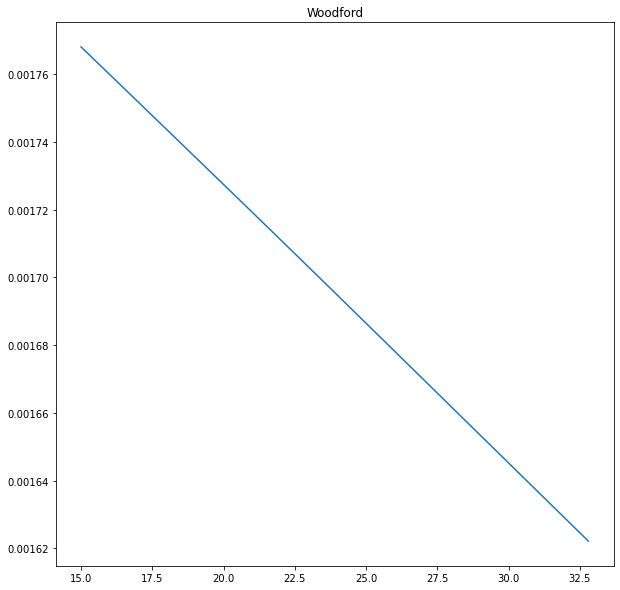

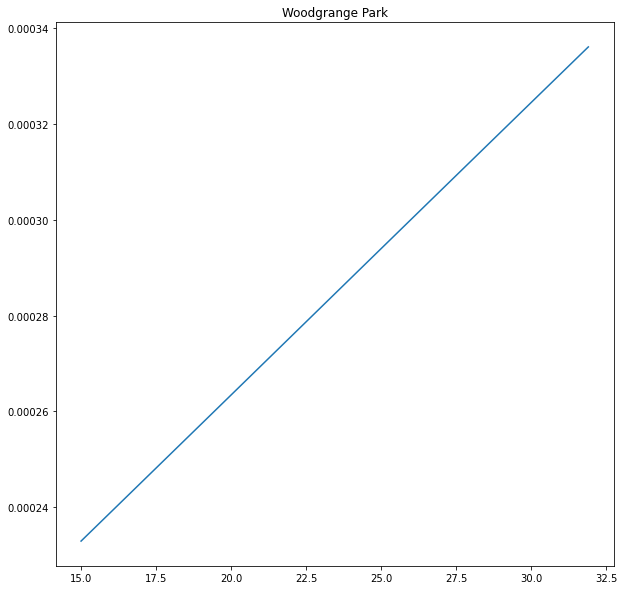

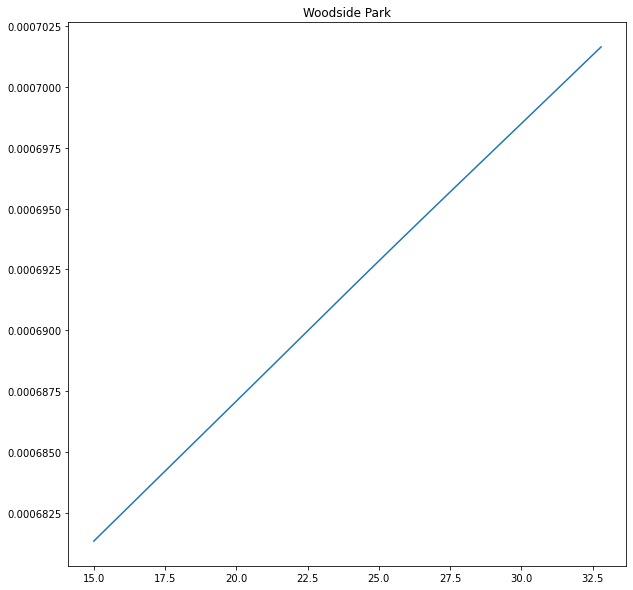

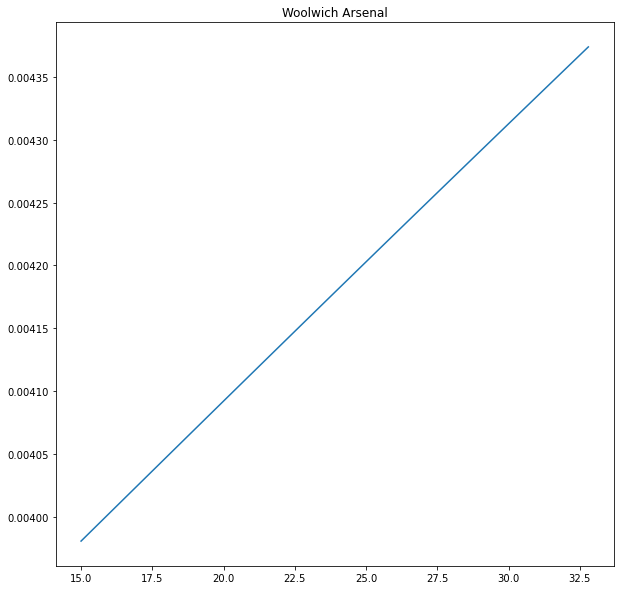

In [70]:
# Assuming `stations` is a list of unique station names in your dataset
stations = filtered_data['Station'].unique()

# Loop over each station and create a GAM model and plot
for i, station in enumerate(stations):
    # Extract data for the current station
    station_data = summer_weekend_usage_temp[summer_weekend_usage_temp['Station'] == station]
    X = station_data['tmax']
    y = station_data['percent_daily_total']
    
    # Fit the GAM model for the current station
    gam = LinearGAM(lam=1e6, n_splines=39).fit(X, y)
    
    # Generate X values for the plot
    XX = gam.generate_X_grid(term=0)
    
    # Create a new figure and plot the GAM model
    plt.figure(figsize=(10, 10))
    plt.plot(XX, gam.predict(XX), label='LinearGAM')
    
    # Set the title of the plot to the station name
    plt.title(station)

    # Show the plot for the current station
    plt.show()

In [71]:
# Assuming `stations` is a list of unique station names in your dataset
stations = filtered_data['Station'].unique()

# Create a new dataframe to store the results
edf_df = pd.DataFrame(columns=['Station', 'EDF'])

# Loop over each station and perform a grid search
for station in stations:
    # Extract data for the current station
    station_data = filtered_data[filtered_data['Station'] == station]
    X = station_data['tmax'].to_numpy().reshape(-1, 1)
    y = station_data['percent_daily_total']
    
    # Perform the grid search for the current station
    gam = LinearGAM(n_splines=50).gridsearch(X, y)
    
    # Extract the Effective Degrees of Freedom (EDF) from the best model
    edf_value = gam.statistics_['edof']
    
    # Append the results to the new dataframe
    edf_df = edf_df.append({'Station': station, 'EDF': edf_value}, ignore_index=True)

# Print the results
print(edf_df)

100% (11 of 11) |########################| Elapsed Time: 0:00:02 Time:  0:00:02
100% (11 of 11) |########################| Elapsed Time: 0:00:03 Time:  0:00:03
100% (11 of 11) |########################| Elapsed Time: 0:00:02 Time:  0:00:02
100% (11 of 11) |########################| Elapsed Time: 0:00:02 Time:  0:00:02
100% (11 of 11) |########################| Elapsed Time: 0:00:02 Time:  0:00:02
100% (11 of 11) |########################| Elapsed Time: 0:00:03 Time:  0:00:03
100% (11 of 11) |########################| Elapsed Time: 0:00:03 Time:  0:00:03
100% (11 of 11) |########################| Elapsed Time: 0:00:02 Time:  0:00:02
100% (11 of 11) |########################| Elapsed Time: 0:00:02 Time:  0:00:02
100% (11 of 11) |########################| Elapsed Time: 0:00:02 Time:  0:00:02
100% (11 of 11) |########################| Elapsed Time: 0:00:02 Time:  0:00:02
100% (11 of 11) |########################| Elapsed Time: 0:00:02 Time:  0:00:02
100% (11 of 11) |#######################

              Station       EDF
0          Abbey Road  4.239125
1          Abbey Wood  5.493351
2       Acton Central  4.172028
3     Acton Main Line  4.026066
4          Acton Town  4.239125
..                ...       ...
380       Wood Street  4.059840
381          Woodford  4.239125
382   Woodgrange Park  3.984207
383     Woodside Park  5.605108
384  Woolwich Arsenal  4.239125

[385 rows x 2 columns]


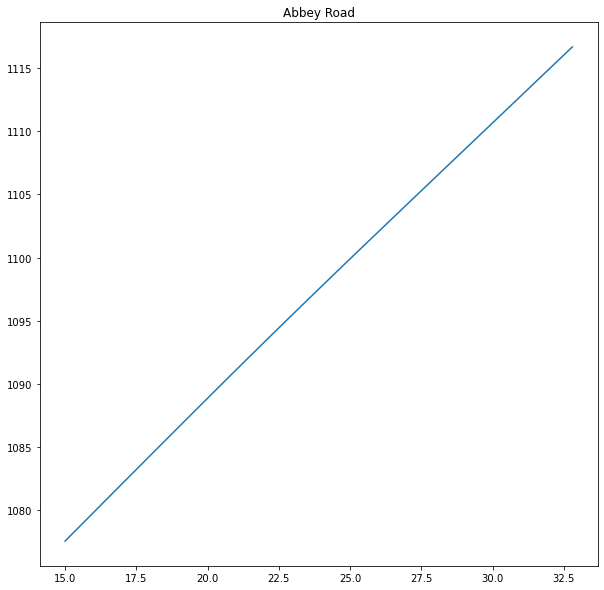

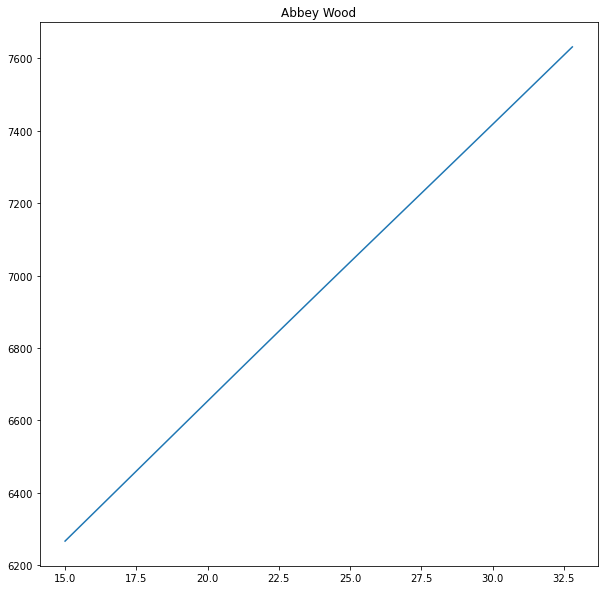

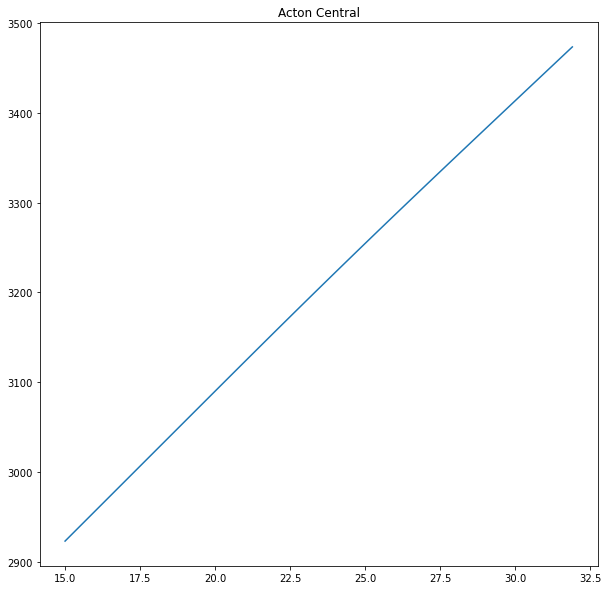

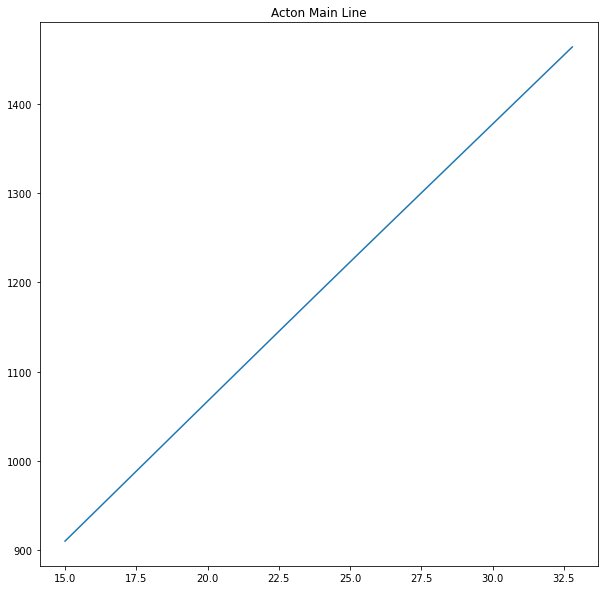

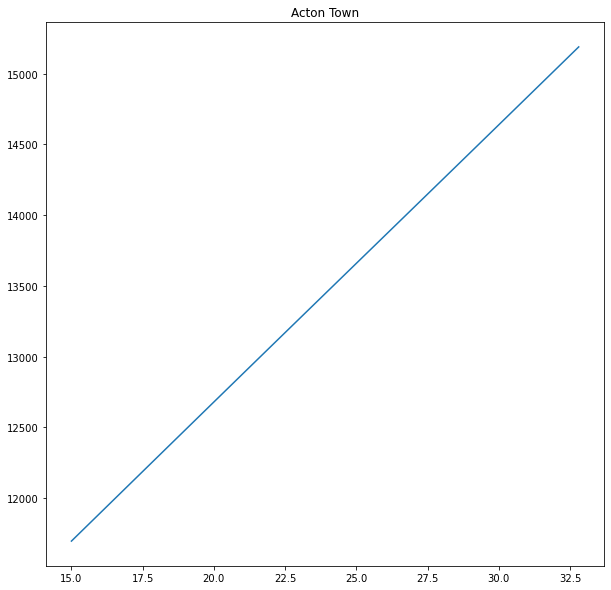

...

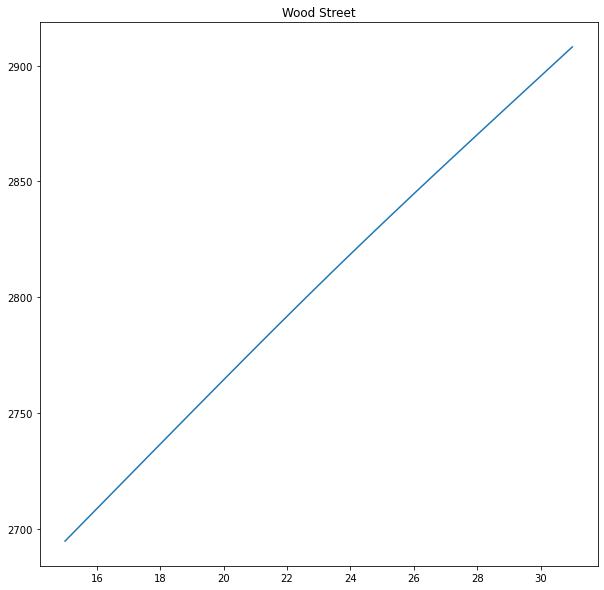

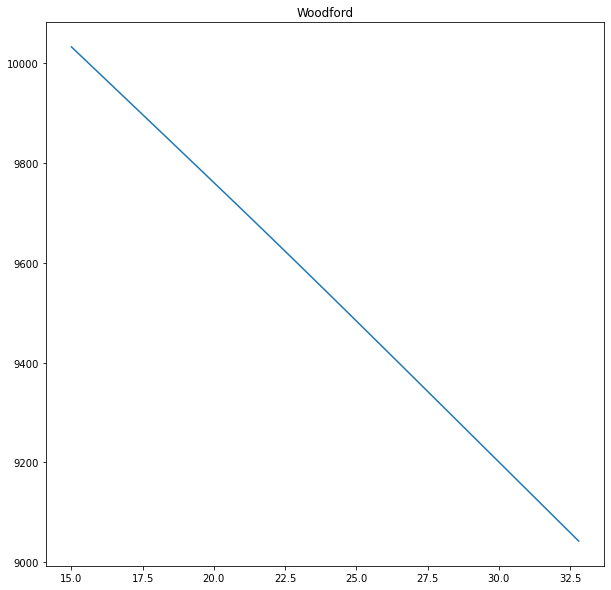

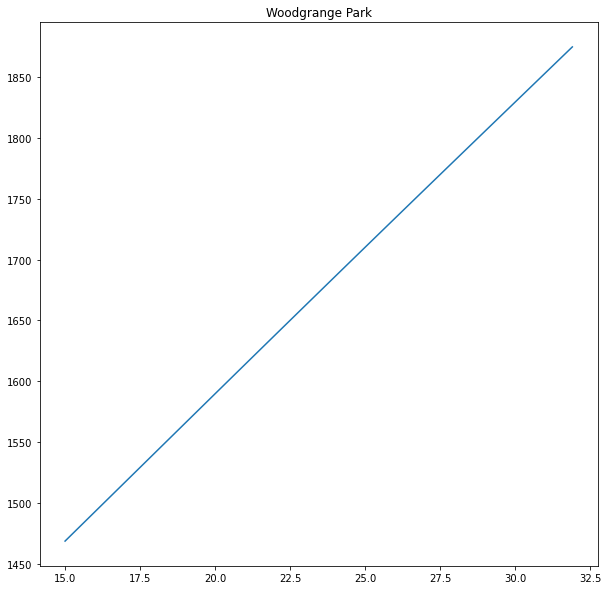

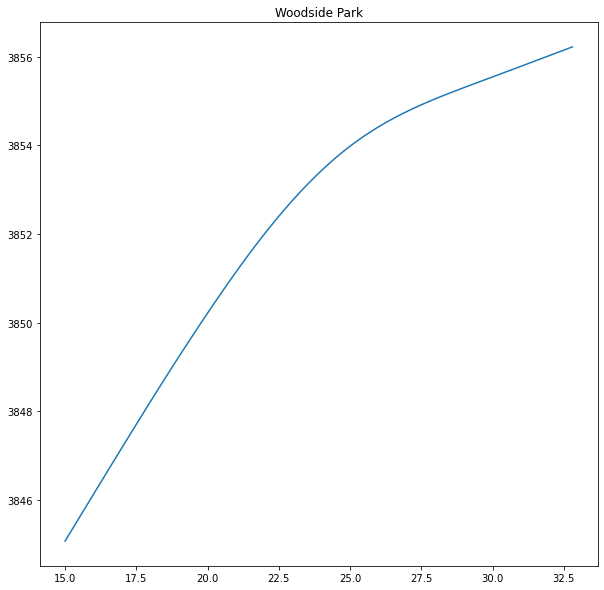

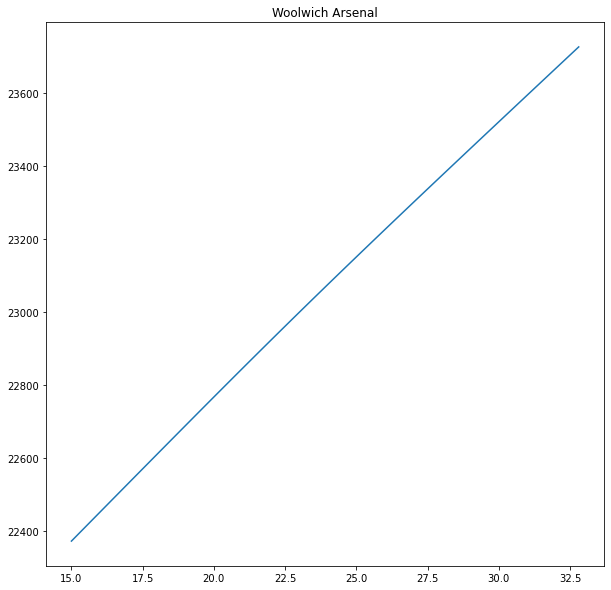

In [72]:
# Loop over each station and create a GAM model and plot
for i, station in enumerate(stations):
    # Extract data for the current station
    station_data = filtered_data[filtered_data['Station'] == station]
    X = station_data['tmax']
    y = station_data['entryexit_total']
    
    # Get the corresponding EDF value from the edf_df dataframe
    edf_value = edf_df.loc[edf_df['Station'] == station, 'EDF'].values[0]
    
    # Set a minimum number of splines based on the spline order
    min_n_splines = int(edf_value) + 1
    
    # Fit the GAM model for the current station with the minimum number of splines
    gam = LinearGAM(lam=1e6, n_splines=max(39, min_n_splines)).fit(X, y)
    
    # Generate X values for the plot
    XX = gam.generate_X_grid(term=0)
    
    # Create a new figure and plot the GAM model
    plt.figure(figsize=(10, 10))
    plt.plot(XX, gam.predict(XX), label='LinearGAM')
    
    # Set the title of the plot to the station name
    plt.title(station)
    
    # Add any other desired plot customization here
    
    # Show the plot for the current station
    plt.show()